<a href="https://colab.research.google.com/github/anubhavgupta1/Udacity/blob/main/Frameworks/Pytorch/GANs/Coursera/Conditional%20-%20GANs/Concise%20Implementation/MNIST.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Build a Conditional GAN

## Packages and Visualization

In [1]:
import math
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

In [2]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

## Generator and Noise

In [3]:
def get_noise(n_samples, input_dim, device='cpu'):
    return torch.randn(n_samples, input_dim, device=device)

In [4]:
class Generator(nn.Module):

    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

## Discriminator

In [5]:
class Discriminator(nn.Module):
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In [6]:
import torch.nn.functional as F

In [7]:
def get_one_hot_labels(labels, n_classes):
    return F.one_hot(labels,n_classes)

In [8]:
def combine_vectors(x, y):
    combined = torch.cat((x.float(),y.float()), 1)
    return combined

## Training Initializations

In [9]:
mnist_shape = (1, 28, 28)
n_classes = 10

In [10]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 50
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

In [11]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

In [12]:
dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw




Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw
Processing...
Done!


/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:480: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [13]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    return generator_input_dim, discriminator_im_chan

In [14]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

In [15]:
gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

In [16]:
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

In [17]:
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

In [18]:
print("Generator Model is : ","\n\n",gen)
print("\n\nDiscriminator Model is : ","\n\n",disc)

Generator Model is :  

 Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(74, 256, kernel_size=(3, 3), stride=(2, 2))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2))
      (1): Tanh()
    )
  )
)


Discriminator Model is :  

 Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Conv2d(11, 64, kernel_size=(4, 4), stride=(2, 2))
      (1): Ba

In [19]:
!pip install colorama
from colorama import Fore, Back, Style 

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 220, Batch = 221 and Epoch = 0


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 221, Batch = 222 and Epoch = 0


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 

Step = 469, Batch = 1 and Epoch = 1


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 470, Batch = 2 and Epoch = 1


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 471, Batch = 3 and Epoch = 1


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Ho

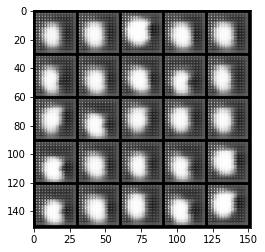

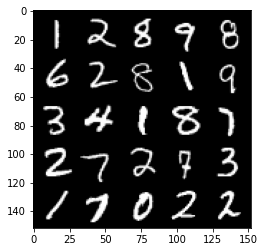

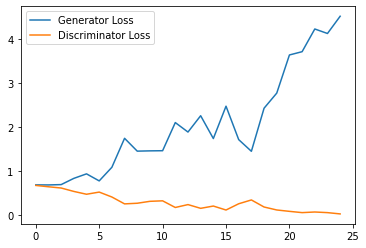

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 689, Batch = 221 and Epoch = 1


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 690, Batch = 222 and Epoch = 1


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 

Step = 938, Batch = 1 and Epoch = 2


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 939, Batch = 2 and Epoch = 2


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 940, Batch = 3 and Epoch = 2


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Ho

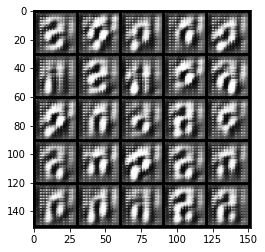

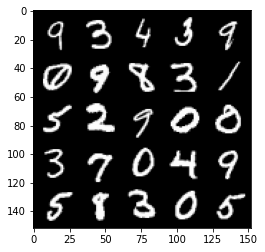

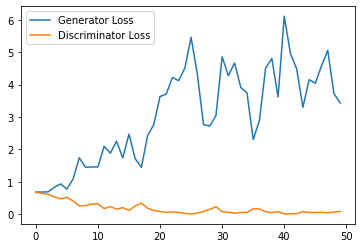

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 1158, Batch = 221 and Epoch = 2


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 1159, Batch = 222 and Epoch = 2


Discriminator
Real Images = 128,1,28,28
One Hot Labels 

Step = 1407, Batch = 1 and Epoch = 3


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 1408, Batch = 2 and Epoch = 3


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 1409, Batch = 3 and Epoch = 3


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One

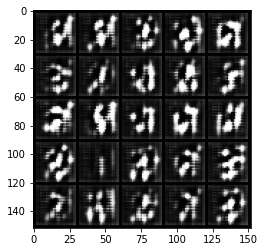

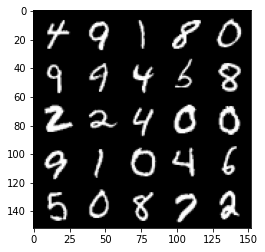

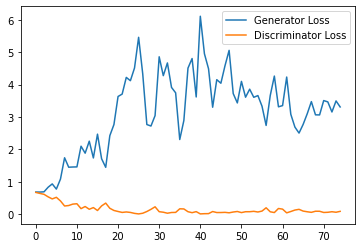

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 1627, Batch = 221 and Epoch = 3


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 1628, Batch = 222 and Epoch = 3


Discriminator
Real Images = 128,1,28,28
One Hot Labels 

Step = 1876, Batch = 1 and Epoch = 4


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 1877, Batch = 2 and Epoch = 4


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 1878, Batch = 3 and Epoch = 4


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One

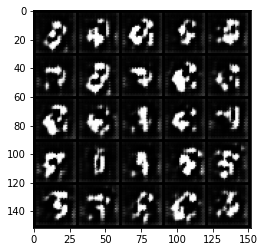

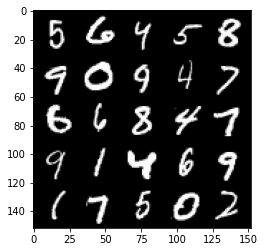

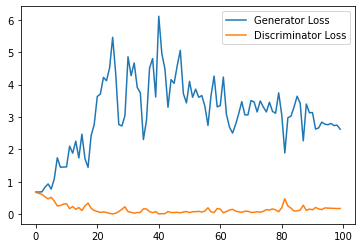

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 2096, Batch = 221 and Epoch = 4


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 2097, Batch = 222 and Epoch = 4


Discriminator
Real Images = 128,1,28,28
One Hot Labels 

Step = 2345, Batch = 1 and Epoch = 5


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 2346, Batch = 2 and Epoch = 5


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 2347, Batch = 3 and Epoch = 5


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One

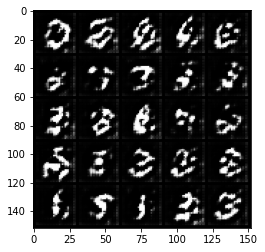

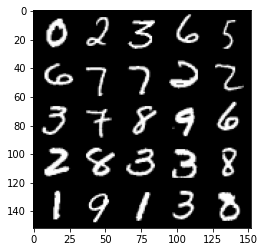

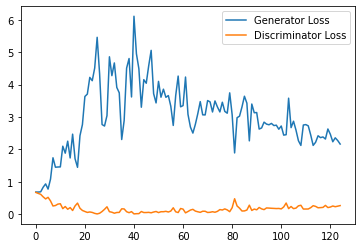

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 2565, Batch = 221 and Epoch = 5


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 2566, Batch = 222 and Epoch = 5


Discriminator
Real Images = 128,1,28,28
One Hot Labels 

Step = 2814, Batch = 1 and Epoch = 6


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 2815, Batch = 2 and Epoch = 6


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 2816, Batch = 3 and Epoch = 6


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One

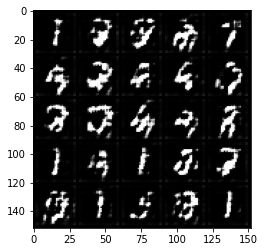

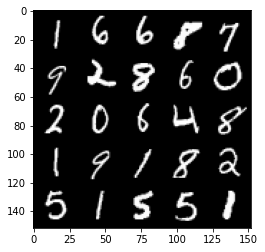

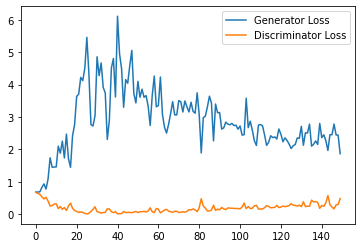

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 3034, Batch = 221 and Epoch = 6


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 3035, Batch = 222 and Epoch = 6


Discriminator
Real Images = 128,1,28,28
One Hot Labels 

Step = 3283, Batch = 1 and Epoch = 7


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 3284, Batch = 2 and Epoch = 7


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 3285, Batch = 3 and Epoch = 7


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One

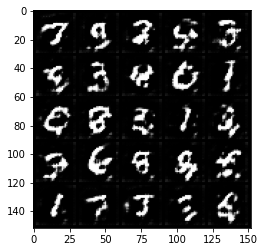

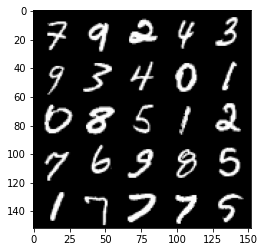

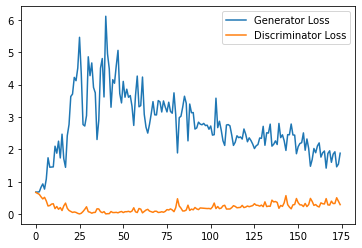

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 3503, Batch = 221 and Epoch = 7


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 3504, Batch = 222 and Epoch = 7


Discriminator
Real Images = 128,1,28,28
One Hot Labels 

Step = 3752, Batch = 1 and Epoch = 8


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 3753, Batch = 2 and Epoch = 8


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 3754, Batch = 3 and Epoch = 8


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One

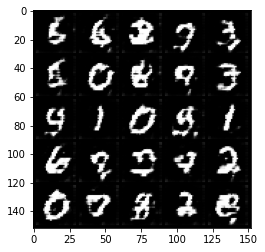

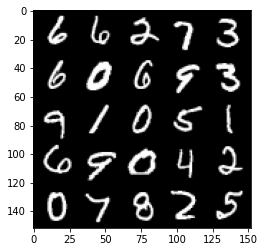

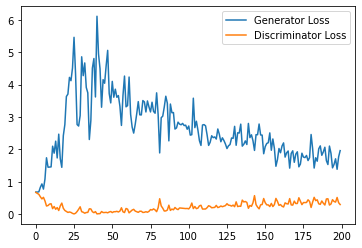

Step = 4001, Batch = 250 and Epoch = 8


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 4002, Batch = 251 and Epoch = 8


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 4003, Batch = 252 and Epoch = 8


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 4252, Batch = 32 and Epoch = 9


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 4253, Batch = 33 and Epoch = 9


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 

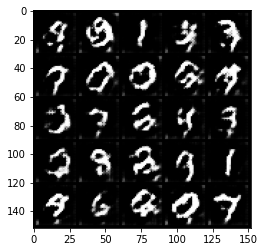

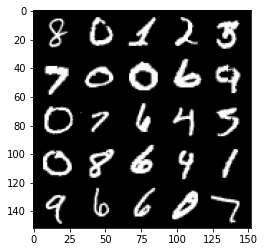

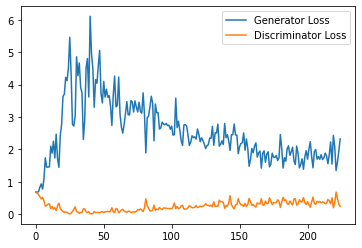

Step = 4501, Batch = 281 and Epoch = 9


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 4502, Batch = 282 and Epoch = 9


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 4503, Batch = 283 and Epoch = 9


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 4752, Batch = 63 and Epoch = 10


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 4753, Batch = 64 and Epoch = 10


Discriminator
Real Images = 128,1,28,28
One Hot Labels 

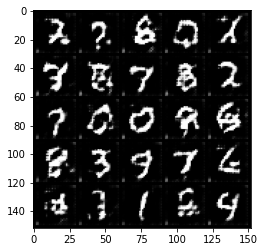

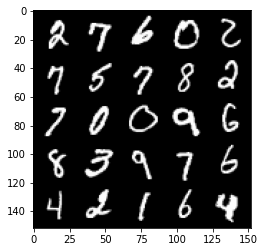

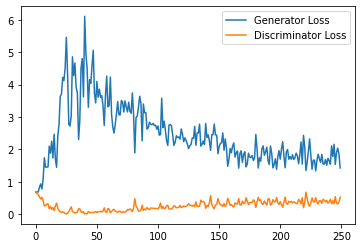

Step = 5001, Batch = 312 and Epoch = 10


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 5002, Batch = 313 and Epoch = 10


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 5003, Batch = 314 and Epoch = 10


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10


Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 5252, Batch = 94 and Epoch = 11


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 5253, Batch = 95 and Epoch = 11


Discriminator
Real Images = 128,1,28,28
One Hot Labels 

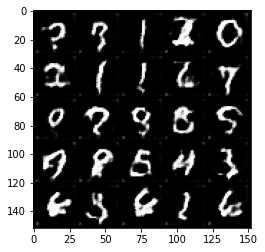

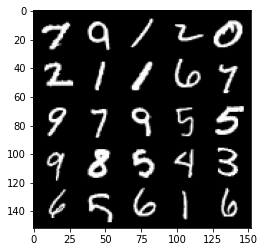

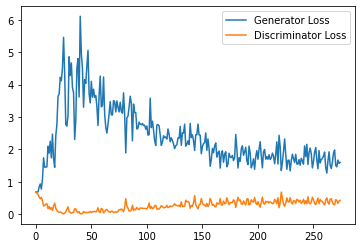

Step = 5501, Batch = 343 and Epoch = 11


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 5502, Batch = 344 and Epoch = 11


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 5503, Batch = 345 and Epoch = 11


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10


Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 5752, Batch = 125 and Epoch = 12


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 5753, Batch = 126 and Epoch = 12


Discriminator
Real Images = 128,1,28,28
One Hot Label

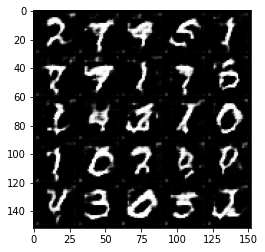

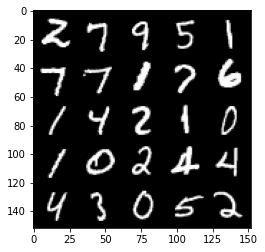

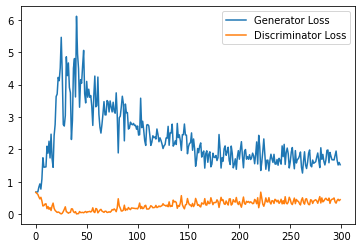

Step = 6001, Batch = 374 and Epoch = 12


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 6002, Batch = 375 and Epoch = 12


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 6003, Batch = 376 and Epoch = 12


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10


Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 6252, Batch = 156 and Epoch = 13


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 6253, Batch = 157 and Epoch = 13


Discriminator
Real Images = 128,1,28,28
One Hot Label

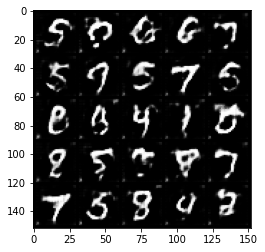

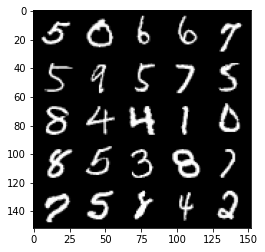

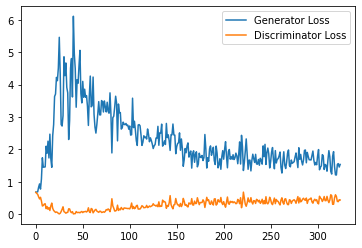

Step = 6501, Batch = 405 and Epoch = 13


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 6502, Batch = 406 and Epoch = 13


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 6503, Batch = 407 and Epoch = 13


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10


Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 6752, Batch = 187 and Epoch = 14


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 6753, Batch = 188 and Epoch = 14


Discriminator
Real Images = 128,1,28,28
One Hot Label

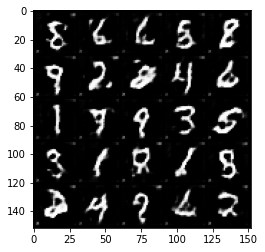

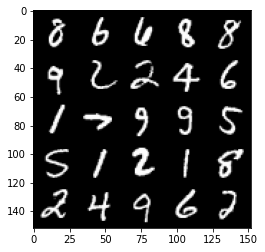

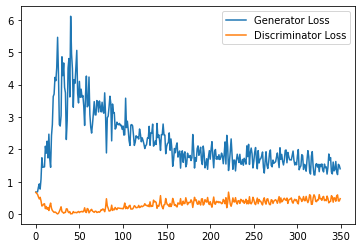

Step = 7001, Batch = 436 and Epoch = 14


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7002, Batch = 437 and Epoch = 14


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7003, Batch = 438 and Epoch = 14


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10


Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7252, Batch = 218 and Epoch = 15


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7253, Batch = 219 and Epoch = 15


Discriminator
Real Images = 128,1,28,28
One Hot Label

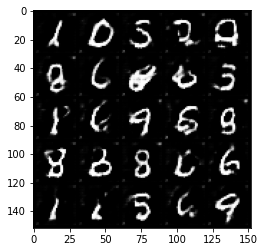

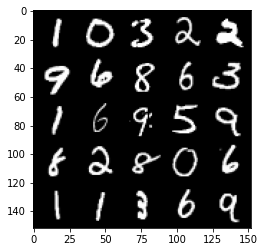

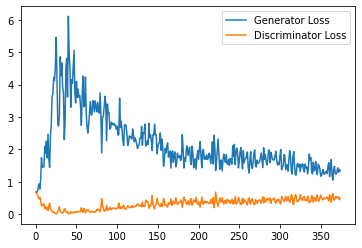

Step = 7501, Batch = 467 and Epoch = 15


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7502, Batch = 468 and Epoch = 15


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7503, Batch = 469 and Epoch = 15


Discriminator
Real Images = 96,1,28,28
One Hot Labels = 96,10
Im

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7724, Batch = 221 and Epoch = 16


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7725, Batch = 222 and Epoch = 16


Discriminator
Real Images = 128,1,28,28
One Hot Label

Step = 7973, Batch = 1 and Epoch = 17


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7974, Batch = 2 and Epoch = 17


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 7975, Batch = 3 and Epoch = 17


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image 

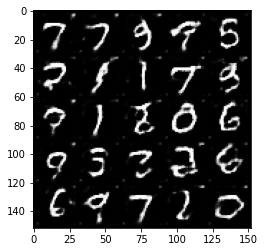

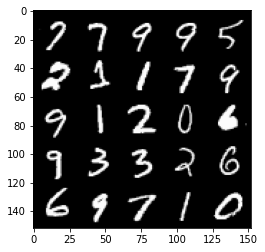

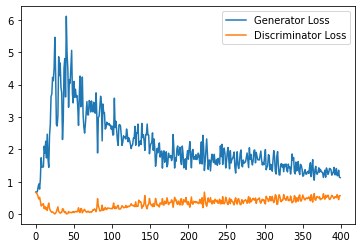

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 8193, Batch = 221 and Epoch = 17


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 8194, Batch = 222 and Epoch = 17


Discriminator
Real Images = 128,1,28,28
One Hot Label

Step = 8442, Batch = 1 and Epoch = 18


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 8443, Batch = 2 and Epoch = 18


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 8444, Batch = 3 and Epoch = 18


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image 

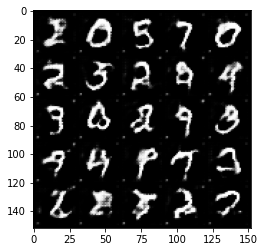

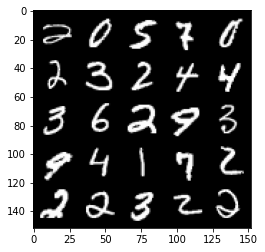

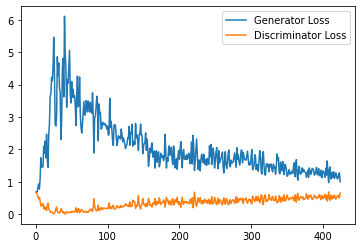

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 8662, Batch = 221 and Epoch = 18


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 8663, Batch = 222 and Epoch = 18


Discriminator
Real Images = 128,1,28,28
One Hot Label

Step = 8911, Batch = 1 and Epoch = 19


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 8912, Batch = 2 and Epoch = 19


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 8913, Batch = 3 and Epoch = 19


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image 

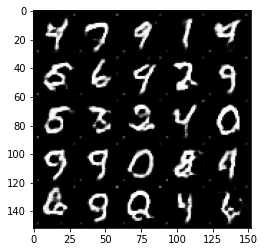

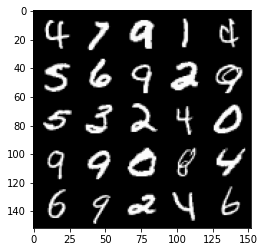

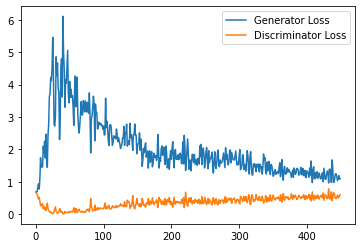

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 9131, Batch = 221 and Epoch = 19


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 9132, Batch = 222 and Epoch = 19


Discriminator
Real Images = 128,1,28,28
One Hot Label

Step = 9380, Batch = 1 and Epoch = 20


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 9381, Batch = 2 and Epoch = 20


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 9382, Batch = 3 and Epoch = 20


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image 

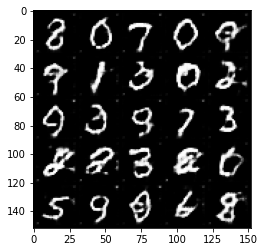

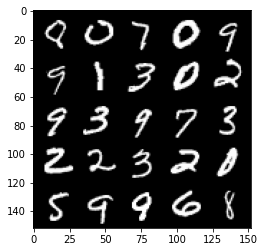

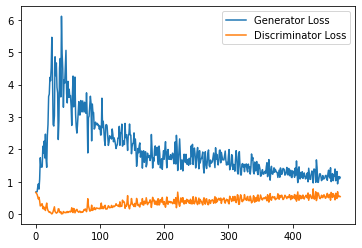

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 9600, Batch = 221 and Epoch = 20


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 9601, Batch = 222 and Epoch = 20


Discriminator
Real Images = 128,1,28,28
One Hot Label

Step = 9849, Batch = 1 and Epoch = 21


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 9850, Batch = 2 and Epoch = 21


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 9851, Batch = 3 and Epoch = 21


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image 

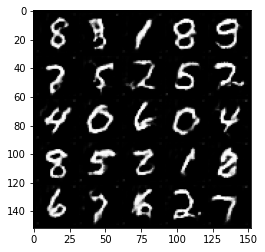

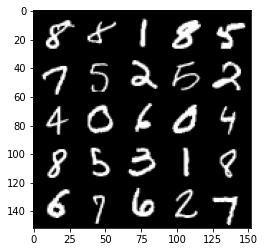

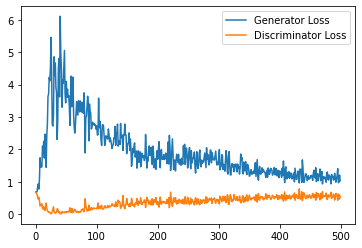

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 10069, Batch = 221 and Epoch = 21


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 10070, Batch = 222 and Epoch = 21


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 10318, Batch = 1 and Epoch = 22


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 10319, Batch = 2 and Epoch = 22


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 10320, Batch = 3 and Epoch = 22


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

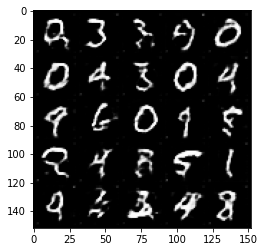

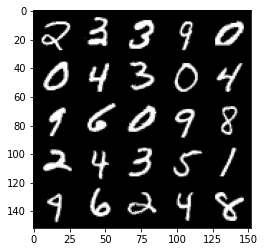

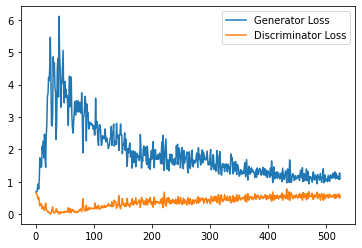

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 10538, Batch = 221 and Epoch = 22


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 10539, Batch = 222 and Epoch = 22


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 10787, Batch = 1 and Epoch = 23


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 10788, Batch = 2 and Epoch = 23


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 10789, Batch = 3 and Epoch = 23


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

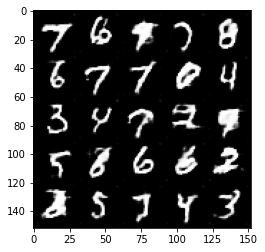

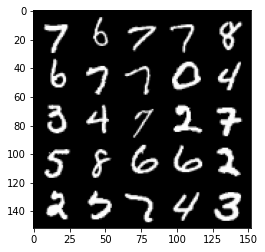

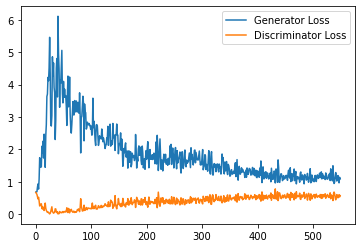

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 11007, Batch = 221 and Epoch = 23


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 11008, Batch = 222 and Epoch = 23


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 11256, Batch = 1 and Epoch = 24


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 11257, Batch = 2 and Epoch = 24


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 11258, Batch = 3 and Epoch = 24


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

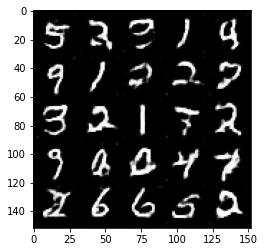

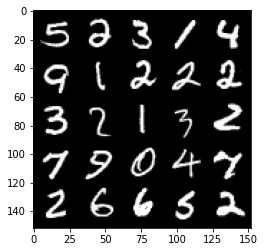

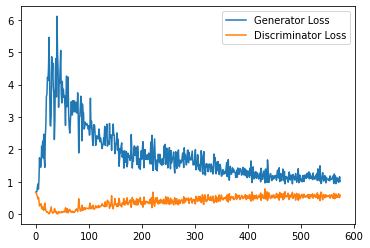

Step = 11501, Batch = 246 and Epoch = 24


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 11502, Batch = 247 and Epoch = 24


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 11503, Batch = 248 and Epoch = 24


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 11752, Batch = 28 and Epoch = 25


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 11753, Batch = 29 and Epoch = 25


Discriminator
Real Images = 128,1,28,28
One Hot Label

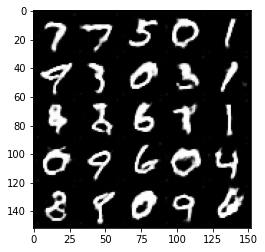

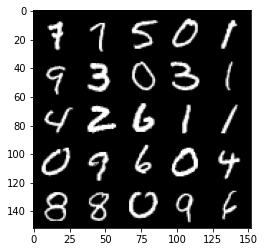

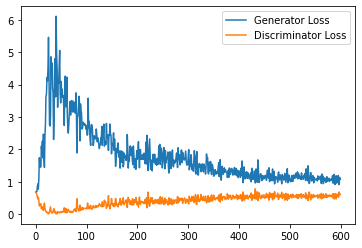

Step = 12001, Batch = 277 and Epoch = 25


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 12002, Batch = 278 and Epoch = 25


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 12003, Batch = 279 and Epoch = 25


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 12252, Batch = 59 and Epoch = 26


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 12253, Batch = 60 and Epoch = 26


Discriminator
Real Images = 128,1,28,28
One Hot Label

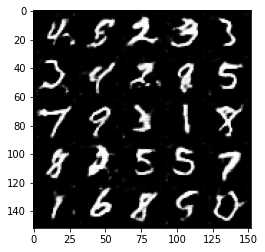

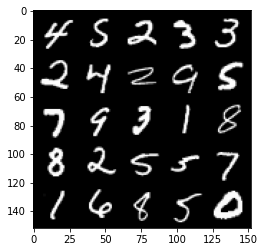

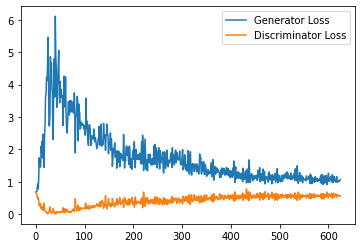

Step = 12501, Batch = 308 and Epoch = 26


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 12502, Batch = 309 and Epoch = 26


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 12503, Batch = 310 and Epoch = 26


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 12752, Batch = 90 and Epoch = 27


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 12753, Batch = 91 and Epoch = 27


Discriminator
Real Images = 128,1,28,28
One Hot Label

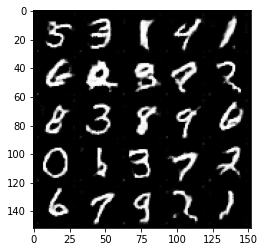

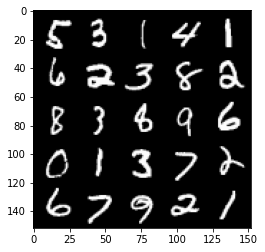

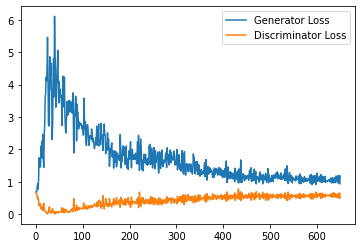

Step = 13001, Batch = 339 and Epoch = 27


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 13002, Batch = 340 and Epoch = 27


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 13003, Batch = 341 and Epoch = 27


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 13252, Batch = 121 and Epoch = 28


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 13253, Batch = 122 and Epoch = 28


Discriminator
Real Images = 128,1,28,28
One Hot Lab

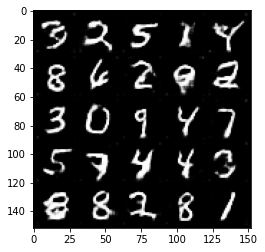

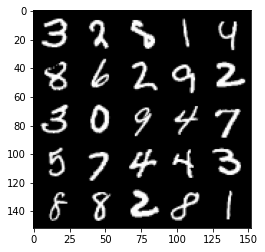

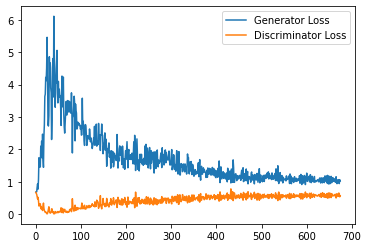

Step = 13501, Batch = 370 and Epoch = 28


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 13502, Batch = 371 and Epoch = 28


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 13503, Batch = 372 and Epoch = 28


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 13752, Batch = 152 and Epoch = 29


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 13753, Batch = 153 and Epoch = 29


Discriminator
Real Images = 128,1,28,28
One Hot Lab

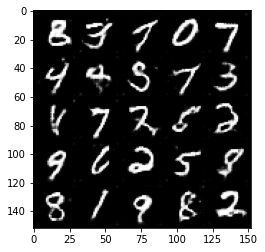

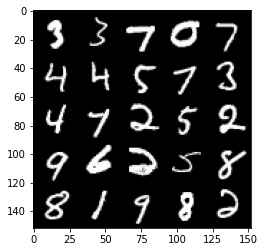

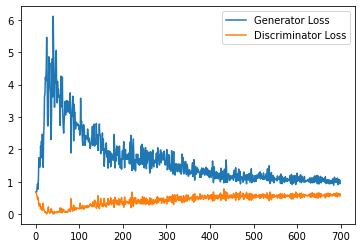

Step = 14001, Batch = 401 and Epoch = 29


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 14002, Batch = 402 and Epoch = 29


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 14003, Batch = 403 and Epoch = 29


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 14252, Batch = 183 and Epoch = 30


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 14253, Batch = 184 and Epoch = 30


Discriminator
Real Images = 128,1,28,28
One Hot Lab

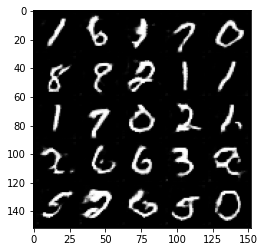

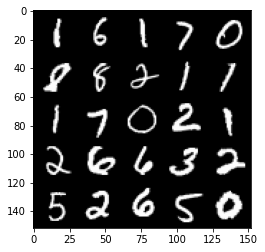

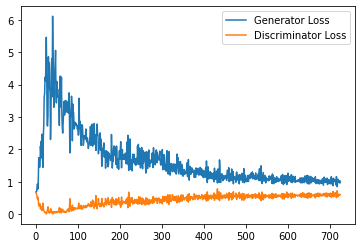

Step = 14501, Batch = 432 and Epoch = 30


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 14502, Batch = 433 and Epoch = 30


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 14503, Batch = 434 and Epoch = 30


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 14752, Batch = 214 and Epoch = 31


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 14753, Batch = 215 and Epoch = 31


Discriminator
Real Images = 128,1,28,28
One Hot Lab

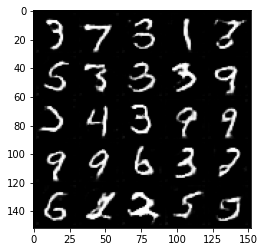

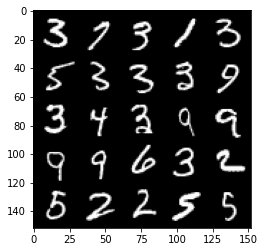

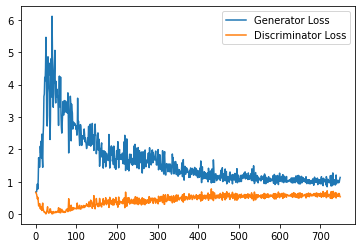

Step = 15001, Batch = 463 and Epoch = 31


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15002, Batch = 464 and Epoch = 31


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15003, Batch = 465 and Epoch = 31


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15228, Batch = 221 and Epoch = 32


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15229, Batch = 222 and Epoch = 32


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 15477, Batch = 1 and Epoch = 33


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15478, Batch = 2 and Epoch = 33


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15479, Batch = 3 and Epoch = 33


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

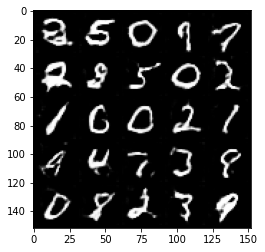

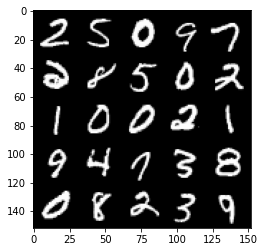

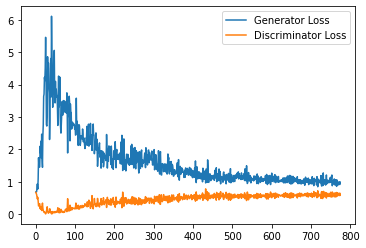

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15697, Batch = 221 and Epoch = 33


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15698, Batch = 222 and Epoch = 33


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 15946, Batch = 1 and Epoch = 34


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15947, Batch = 2 and Epoch = 34


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 15948, Batch = 3 and Epoch = 34


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

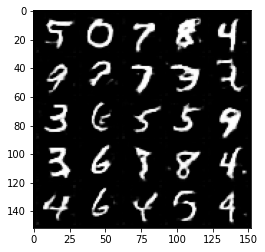

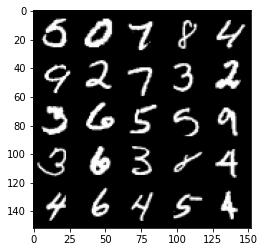

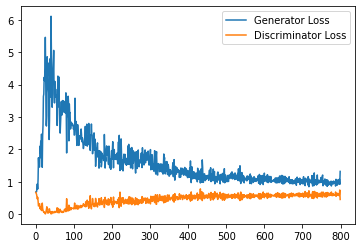

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 16166, Batch = 221 and Epoch = 34


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 16167, Batch = 222 and Epoch = 34


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 16415, Batch = 1 and Epoch = 35


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 16416, Batch = 2 and Epoch = 35


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 16417, Batch = 3 and Epoch = 35


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

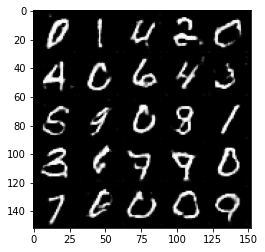

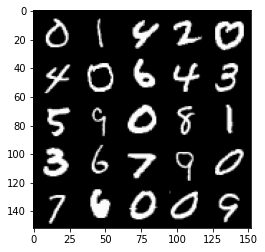

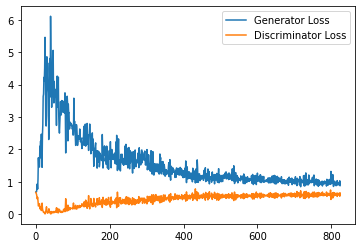

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 16635, Batch = 221 and Epoch = 35


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 16636, Batch = 222 and Epoch = 35


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 16884, Batch = 1 and Epoch = 36


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 16885, Batch = 2 and Epoch = 36


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 16886, Batch = 3 and Epoch = 36


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

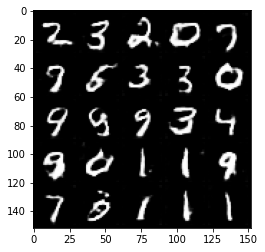

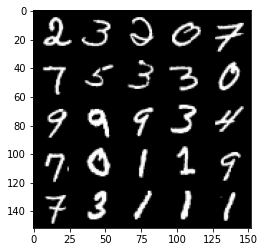

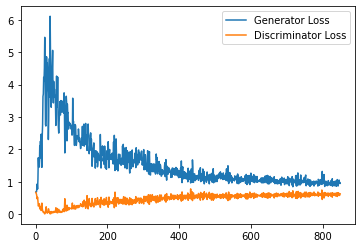

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 17104, Batch = 221 and Epoch = 36


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 17105, Batch = 222 and Epoch = 36


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 17353, Batch = 1 and Epoch = 37


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 17354, Batch = 2 and Epoch = 37


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 17355, Batch = 3 and Epoch = 37


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

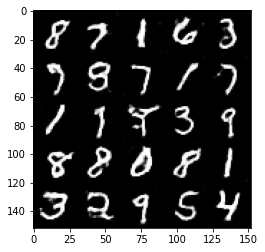

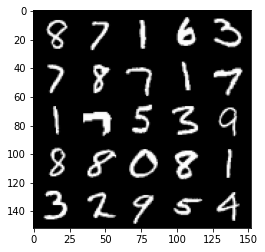

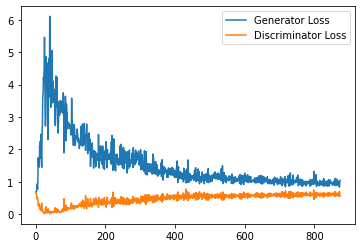

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 17573, Batch = 221 and Epoch = 37


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 17574, Batch = 222 and Epoch = 37


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 17822, Batch = 1 and Epoch = 38


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 17823, Batch = 2 and Epoch = 38


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 17824, Batch = 3 and Epoch = 38


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

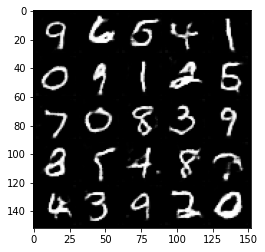

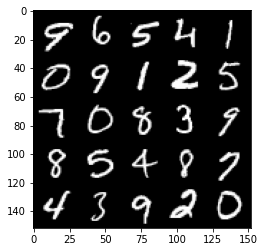

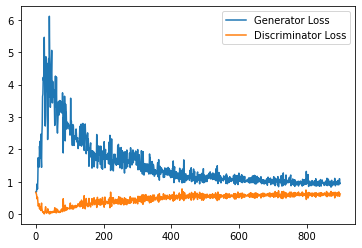

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 18042, Batch = 221 and Epoch = 38


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 18043, Batch = 222 and Epoch = 38


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 18291, Batch = 1 and Epoch = 39


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 18292, Batch = 2 and Epoch = 39


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 18293, Batch = 3 and Epoch = 39


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

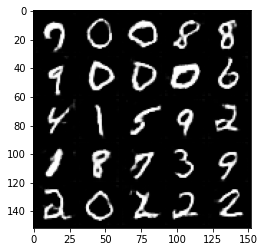

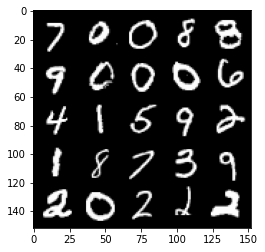

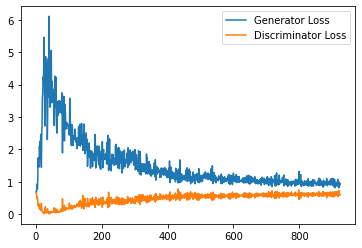

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 18511, Batch = 221 and Epoch = 39


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 18512, Batch = 222 and Epoch = 39


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 18760, Batch = 1 and Epoch = 40


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 18761, Batch = 2 and Epoch = 40


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 18762, Batch = 3 and Epoch = 40


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

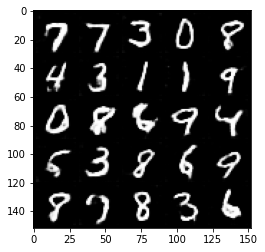

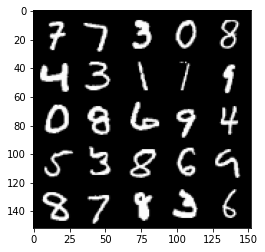

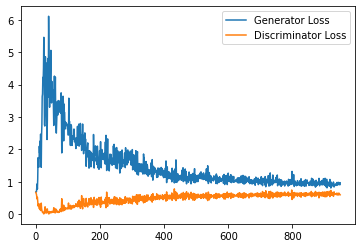

Step = 19001, Batch = 242 and Epoch = 40


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 19002, Batch = 243 and Epoch = 40


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 19003, Batch = 244 and Epoch = 40


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 19252, Batch = 24 and Epoch = 41


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 19253, Batch = 25 and Epoch = 41


Discriminator
Real Images = 128,1,28,28
One Hot Label

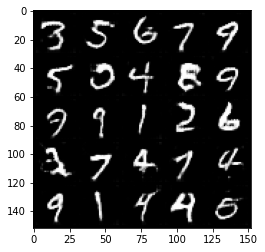

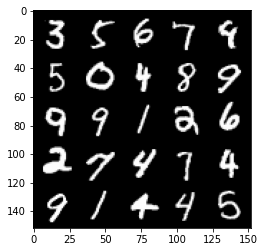

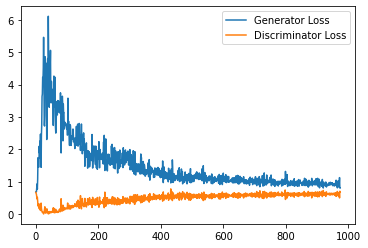

Step = 19501, Batch = 273 and Epoch = 41


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 19502, Batch = 274 and Epoch = 41


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 19503, Batch = 275 and Epoch = 41


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 19752, Batch = 55 and Epoch = 42


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 19753, Batch = 56 and Epoch = 42


Discriminator
Real Images = 128,1,28,28
One Hot Label

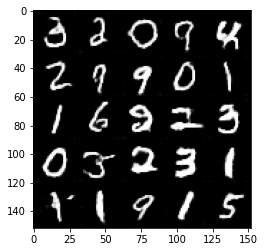

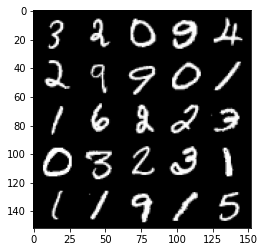

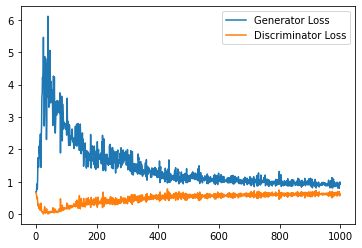

Step = 20001, Batch = 304 and Epoch = 42


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 20002, Batch = 305 and Epoch = 42


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 20003, Batch = 306 and Epoch = 42


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 20252, Batch = 86 and Epoch = 43


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 20253, Batch = 87 and Epoch = 43


Discriminator
Real Images = 128,1,28,28
One Hot Label

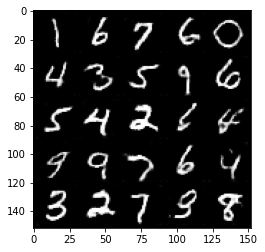

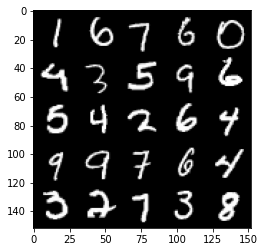

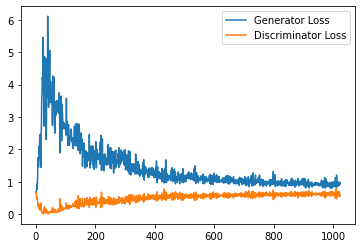

Step = 20501, Batch = 335 and Epoch = 43


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 20502, Batch = 336 and Epoch = 43


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 20503, Batch = 337 and Epoch = 43


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 20752, Batch = 117 and Epoch = 44


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 20753, Batch = 118 and Epoch = 44


Discriminator
Real Images = 128,1,28,28
One Hot Lab

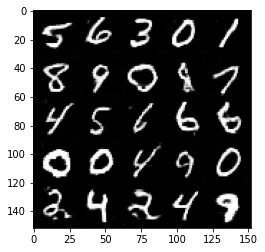

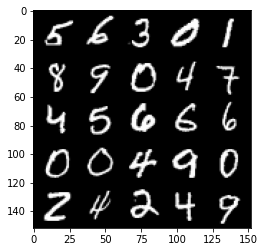

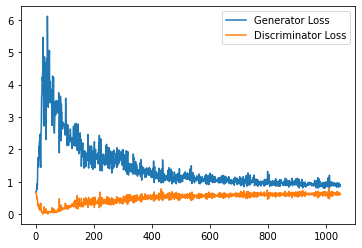

Step = 21001, Batch = 366 and Epoch = 44


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 21002, Batch = 367 and Epoch = 44


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 21003, Batch = 368 and Epoch = 44


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 21252, Batch = 148 and Epoch = 45


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 21253, Batch = 149 and Epoch = 45


Discriminator
Real Images = 128,1,28,28
One Hot Lab

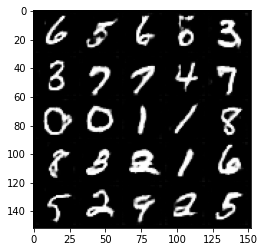

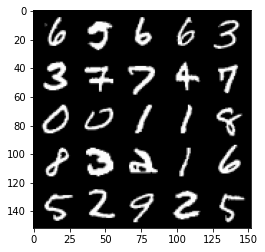

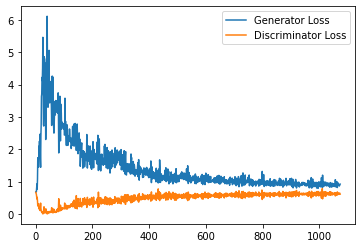

Step = 21501, Batch = 397 and Epoch = 45


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 21502, Batch = 398 and Epoch = 45


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 21503, Batch = 399 and Epoch = 45


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 21752, Batch = 179 and Epoch = 46


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 21753, Batch = 180 and Epoch = 46


Discriminator
Real Images = 128,1,28,28
One Hot Lab

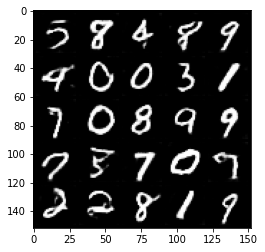

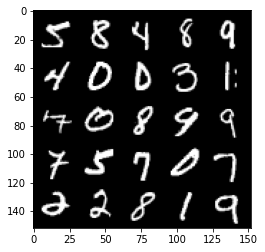

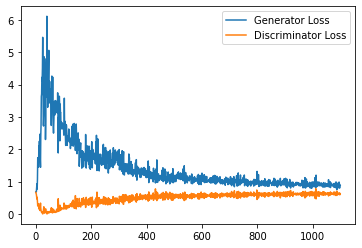

Step = 22001, Batch = 428 and Epoch = 46


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22002, Batch = 429 and Epoch = 46


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22003, Batch = 430 and Epoch = 46


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22252, Batch = 210 and Epoch = 47


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22253, Batch = 211 and Epoch = 47


Discriminator
Real Images = 128,1,28,28
One Hot Lab

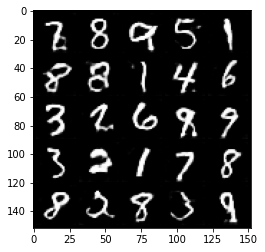

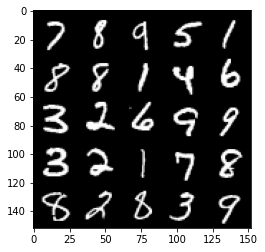

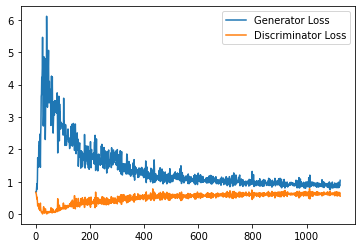

Step = 22501, Batch = 459 and Epoch = 47


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22502, Batch = 460 and Epoch = 47


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22503, Batch = 461 and Epoch = 47


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22732, Batch = 221 and Epoch = 48


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22733, Batch = 222 and Epoch = 48


Discriminator
Real Images = 128,1,28,28
One Hot Lab

Step = 22981, Batch = 1 and Epoch = 49


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22982, Batch = 2 and Epoch = 49


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 22983, Batch = 3 and Epoch = 49


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Ima

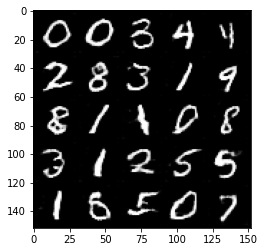

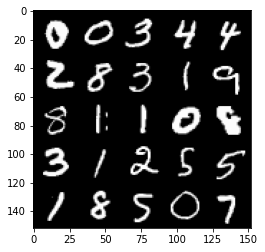

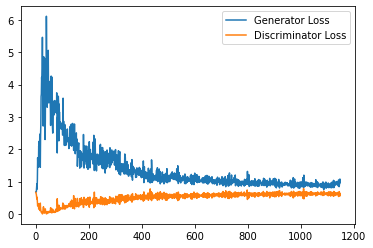

Streaming output truncated to the last 5000 lines.


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 23201, Batch = 221 and Epoch = 49


Discriminator
Real Images = 128,1,28,28
One Hot Labels = 128,10
Image One Hot Labels = 128,10,1,1
Image One Hot Labels = 128,10,28,28
Noise = 128,64
Combined Noise and Labels = 128,74
Fake Images = 128,1,28,28
Real Image and Labels = 128,11,28,28
Fake Image and Labels = 128,11,28,28
Real Prediction = 128,1
Fake Prediction = 128,1

Generator
Fake Image and Labels = 128,11,28,28
Fake Prediction = 128,1

Step = 23202, Batch = 222 and Epoch = 49


Discriminator
Real Images = 128,1,28,28
One Hot Lab

In [20]:
cur_step = 0
generator_losses = []
discriminator_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    batch = 0
    for real, labels in tqdm(dataloader):
        batch = batch + 1
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        #print("\033[4;31;47m Step = {}, Batch = {} and Epoch = {}\n".format(cur_step,batch,epoch)
        print(Fore.RED + "Step = {}, Batch = {} and Epoch = {}".format(cur_step,batch,epoch))
        print(Style.RESET_ALL) 
        
        real = real.to(device)
        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        print("\nDiscriminator")
        print("Real Images = {},{},{},{}".format(real.shape[0],real.shape[1],real.shape[2],real.shape[3]))
        print("One Hot Labels = {},{}".format(one_hot_labels.shape[0],one_hot_labels.shape[1]))

        image_one_hot_labels = one_hot_labels[:, :, None, None]
        print("Image One Hot Labels = {},{},{},{}".format(image_one_hot_labels.shape[0],image_one_hot_labels.shape[1],image_one_hot_labels.shape[2],image_one_hot_labels.shape[3]))
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])
        print("Image One Hot Labels = {},{},{},{}".format(image_one_hot_labels.shape[0],image_one_hot_labels.shape[1],image_one_hot_labels.shape[2],image_one_hot_labels.shape[3]))

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        print("Noise = {},{}".format(fake_noise.shape[0],fake_noise.shape[1]))
        

        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        print("Combined Noise and Labels = {},{}".format(noise_and_labels.shape[0],noise_and_labels.shape[1]))
        fake = gen(noise_and_labels)
        print("Fake Images = {},{},{},{}".format(fake.shape[0],fake.shape[1],fake.shape[2],fake.shape[3]))
    
        
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        print("Real Image and Labels = {},{},{},{}".format(real_image_and_labels.shape[0],real_image_and_labels.shape[1],real_image_and_labels.shape[2],real_image_and_labels.shape[3]))
        print("Fake Image and Labels = {},{},{},{}".format(fake_image_and_labels.shape[0],fake_image_and_labels.shape[1],fake_image_and_labels.shape[2],fake_image_and_labels.shape[3]))
        
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        print("Real Prediction = {},{}".format(disc_real_pred.shape[0],disc_real_pred.shape[1]))
        print("Fake Prediction = {},{}".format(disc_fake_pred.shape[0],disc_fake_pred.shape[1]))
       
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()
        print("\nGenerator")

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        print("Fake Image and Labels = {},{},{},{}".format(fake_image_and_labels.shape[0],fake_image_and_labels.shape[1],fake_image_and_labels.shape[2],fake_image_and_labels.shape[3]))
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        print("Fake Prediction = {},{}\n".format(disc_fake_pred.shape[0],disc_fake_pred.shape[1]))
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        xxx

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        cur_step += 1

## Exploration

In [21]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

In [22]:
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)
interpolation_noise.shape

torch.Size([9, 64])

In [23]:
def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    #print("First Label = {}".format(first_label))

    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)
    #print("Second Label = {}".format(second_label))

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    #print("% Second Label = {}".format(percent_second_label))

    

    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label
    #print("Interpolation Labels = {}".format(interpolation_labels))



    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

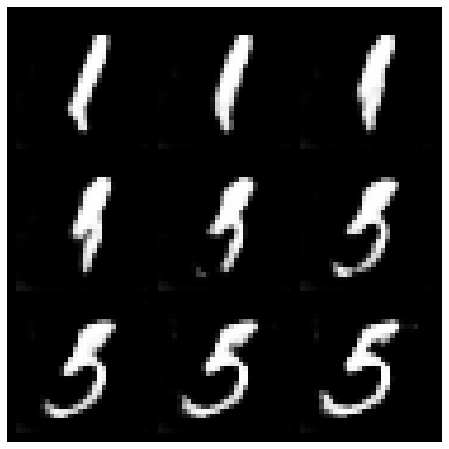

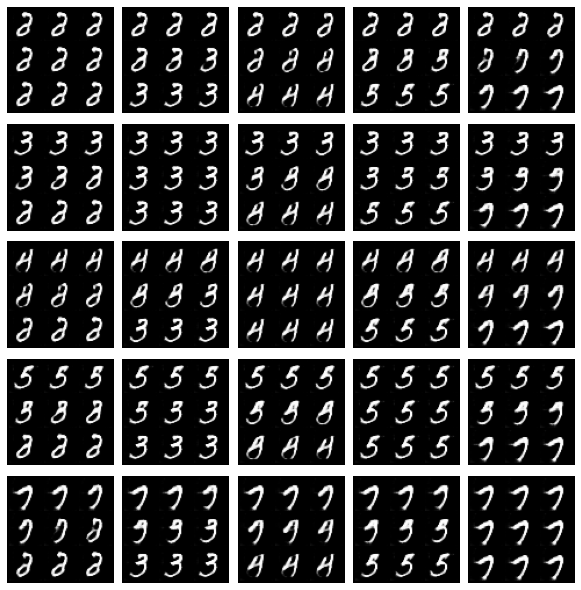

In [24]:
### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')


plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
     for j, second_plot_number in enumerate(plot_numbers):
         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
         interpolate_class(first_plot_number, second_plot_number)
         plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

In [25]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

In [26]:
def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

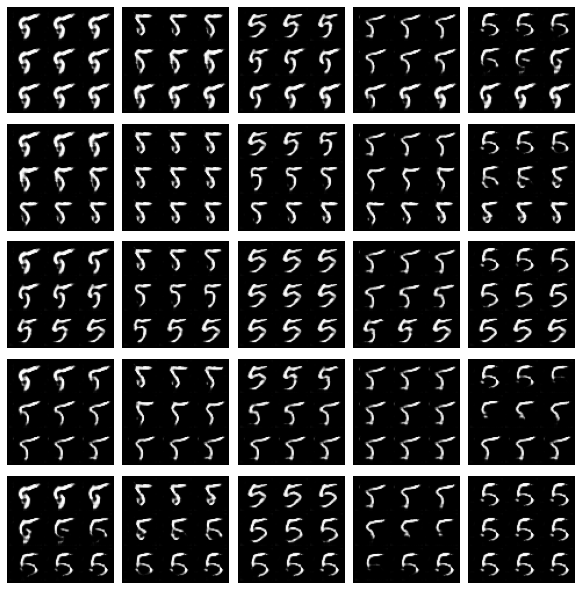

In [27]:
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()